<a href="https://colab.research.google.com/github/Arphor/Acoustic-Fire-Extinguisher-Classification/blob/main/Yolov5_Aquario.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

import torch
import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v6.2-236-g078059c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 22.6/78.2 GB disk)


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="7sK0GCtH8JdCqhIBtDjt")
project = rf.workspace("brad-dwyer").project("aquarium-combined")
dataset = project.version(1).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 41 kB 158 kB/s 
     |████████████████████████████████| 67 kB 1.5 MB/s 
     |████████████████████████████████| 54 kB 3.2 MB/s 
     |████████████████████████████████| 145 kB 73.1 MB/s 
     |████████████████████████████████| 138 kB 68.3 MB/s 
     |████████████████████████████████| 178 kB 64.2 MB/s 
     |████████████████████████████████| 62 kB 1.7 MB/s 
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9675 sha256=7dd93eee27054d111bbe6f0d4a1f0260df11fefddf943c6fe12cd158aa42c47d
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built wget
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3
  Attempting uninstall: certifi
    Found existing installation: certi

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Aquarium-Combined-1 in yolov5pytorch:: 100%|██████████| 8963/8963 [00:04<00:00, 2163.88it/s]


In [ ]:
import torch
from yolov5 import utils
import torch
import utils
from IPython import display
from IPython.display import clear_output
from pathlib import Path
import yaml
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

In [ ]:
Path(f"/content/Aquarium-Combined-1/images/train").mkdir(parents=True, exist_ok=True)
Path(f"/content/Aquarium-Combined-1/images/valid").mkdir(parents=True, exist_ok=True)
Path(f"/content/Aquarium-Combined-1/images/test").mkdir(parents=True, exist_ok=True)
Path(f"/content/Aquarium-Combined-1/labels/train").mkdir(parents=True, exist_ok=True)
Path(f"/content/Aquarium-Combined-1/labels/valid").mkdir(parents=True, exist_ok=True)
Path(f"/content/Aquarium-Combined-1/labels/test").mkdir(parents=True, exist_ok=True)

In [ ]:
!cat /content/yolov5/Aquarium-Combined-1/data.yaml
print ('---------------------------------------------')

names:
- fish
- jellyfish
- penguin
- puffin
- shark
- starfish
- stingray
nc: 7
train: Aquarium-Combined-1/train/images
val: Aquarium-Combined-1/valid/images
---------------------------------------------


In [ ]:
!python train.py --batch 32 --epochs 150 --data '/content/yolov5/Aquarium-Combined-1/data.yaml' --weights 'yolov5s6.pt' --project 'runs_penguins' --name 'feature_extraction' --cache --freeze 12


train: weights=yolov5s6.pt, cfg=, data=/content/yolov5/Aquarium-Combined-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs_penguins, name=feature_extraction, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[12], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-236-g078059c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=

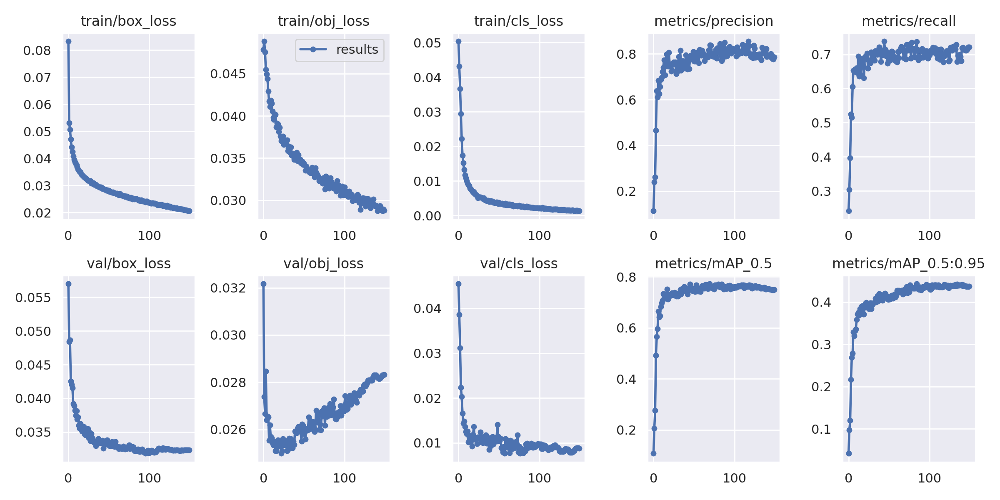

In [ ]:
display.Image(f"runs_penguins/feature_extraction/results.png")

In [ ]:
!python train.py --hyp '/content/yolov5/runs_penguins/feature_extraction/hyp.yaml' --batch 16 --epochs 100 --data '/content/yolov5/Aquarium-Combined-1/data.yaml' --weights 'runs_penguins/feature_extraction/weights/best.pt' --project 'runs_penguins' --name 'fine-tuning' --cache

train: weights=runs_penguins/feature_extraction/weights/best.pt, cfg=, data=/content/yolov5/Aquarium-Combined-1/data.yaml, hyp=/content/yolov5/runs_penguins/feature_extraction/hyp.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs_penguins, name=fine-tuning, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-236-g078059c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.

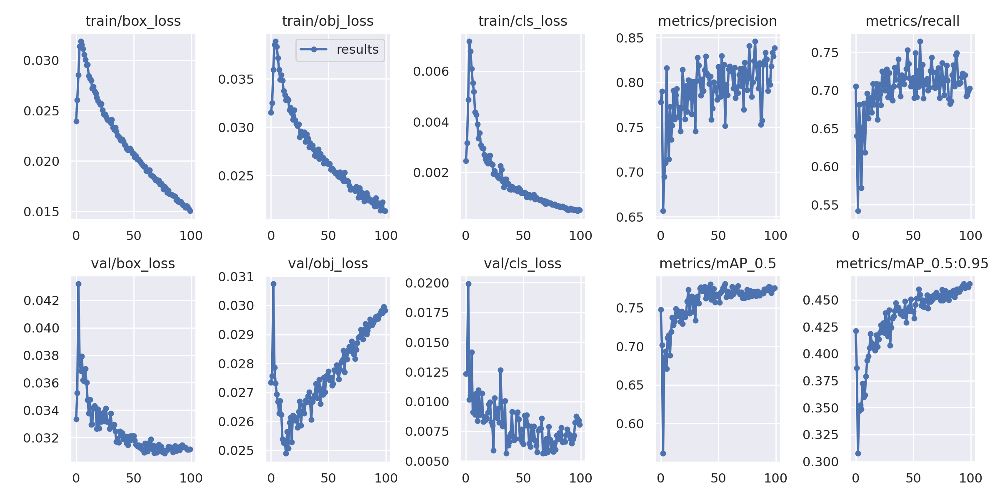

In [ ]:
display.Image(f"runs_penguins/fine-tuning2/results.png")

In [ ]:
!python val.py --weights 'runs_penguins/fine-tuning2/weights/best.pt' --batch 64 --data '/content/yolov5/Aquarium-Combined-1/data.yaml' --task val --project 'runs_penguins' --name 'validation_on_test_data' --augment

val: data=/content/yolov5/Aquarium-Combined-1/data.yaml, weights=['runs_penguins/fine-tuning2/weights/best.pt'], batch_size=64, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=True, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs_penguins, name=validation_on_test_data, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.2-236-g078059c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 206 layers, 12331312 parameters, 0 gradients, 16.2 GFLOPs
val: Scanning '/content/yolov5/Aquarium-Combined-1/valid/labels.cache' images and labels... 127 found, 0 missing, 0 empty, 0 corrupt: 100% 127/127 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 2/2 [00:05<00:00,  2.80s/it]
                   all        127        909      0.811       0.72      0.787      0.461
                  fis

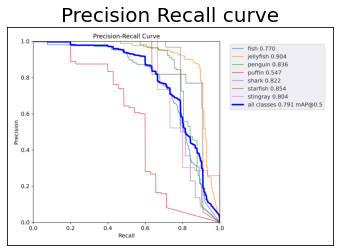

In [ ]:
plt.plot(figsize=(40,40))
plt.title('Precision Recall curve', fontsize=20)
plt.tick_params(left = False, right = False , labelleft = False, labelbottom = False, bottom = False)
plt.imshow(mpimg.imread('runs_penguins/validation_on_test_data2/PR_curve.png'))

In [ ]:
!python detect.py --weights 'runs_penguins/fine-tuning2/weights/best.pt'  --conf 0.6 --source '/content/yolov5/Aquarium-Combined-1/test/images' --project 'runs_penguins' --name 'detect_test' --augment --line=3


detect: weights=['runs_penguins/fine-tuning2/weights/best.pt'], source=/content/yolov5/Aquarium-Combined-1/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=True, visualize=False, update=False, project=runs_penguins, name=detect_test, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-236-g078059c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 206 layers, 12331312 parameters, 0 gradients, 16.2 GFLOPs
image 1/63 /content/yolov5/Aquarium-Combined-1/test/images/IMG_2289_jpeg_jpg.rf.51ba634cbd37b0e233f56f672158f2f7.jpg: 640x640 1 puffin, 1 shark, 41.1ms
image 2/63 /content/yolov5/Aquarium-Combined-1/test/images/IMG_2301_jpeg_jpg.rf.07132817eb88ac368cc85c34484f6ca5.jpg: 640x640 12 penguins, 41.3ms

In [ ]:
detect_path = r'runs_penguins/detect_test2'

images = []
for img_path in glob.glob(detect_path + '/*.jpg'):
    images.append(mpimg.imread(img_path))

plt.figure(figsize=(240,300))
columns = 2
for i, image in enumerate(images):
    plt.subplot((int(len(images) / columns + 1)), columns, i + 1)
    plt.tick_params(left = False, right = False , labelleft = False, labelbottom = False, bottom = False)
    plt.imshow(image)